pygame 2.5.2 (SDL 2.28.3, Python 3.11.5)
Hello from the pygame community. https://www.pygame.org/contribute.html
values:  [ 0.13  0.13 -0.08  0.13  0.32 -0.08  0.13  0.13  0.13  0.49 -0.08  0.49]
values:  [0.32 0.32 0.13 0.32 0.5  0.13 0.32 0.32 0.32 0.65 0.13 0.65]
values:  [ 0.13  0.13 -0.08  0.13  0.32 -0.08  0.13  0.13  0.13  0.49 -0.08  0.49]
values:  [ 0.13  0.13 -0.08  0.13  0.32 -0.08  0.13  0.13  0.13  0.49 -0.08  0.49
  0.49 -0.08 -0.08  0.49  0.32  0.49  0.49  0.49 -0.08  0.13  0.49  0.13
  0.13  0.49 -0.08  0.32  0.13  0.49  0.49  0.32 -0.08  0.32]
values:  [0.32 0.32 0.13 0.32 0.5  0.13 0.32 0.32 0.32 0.65 0.13 0.65 0.65 0.13
 0.13 0.65 0.5  0.65 0.65 0.65 0.13 0.32 0.65 0.32 0.32 0.65 0.13 0.49
 0.32 0.65 0.65 0.5  0.13 0.49]
values:  [ 0.13  0.13 -0.08  0.13  0.32 -0.08  0.13  0.13  0.13  0.49 -0.08  0.49
  0.49 -0.08 -0.08  0.49  0.32  0.49  0.49  0.49 -0.08  0.13  0.49  0.13
  0.13  0.49 -0.08  0.32  0.13  0.49  0.49  0.32 -0.08  0.32]
values:  [-0.08  0.13  0.32 -0.08

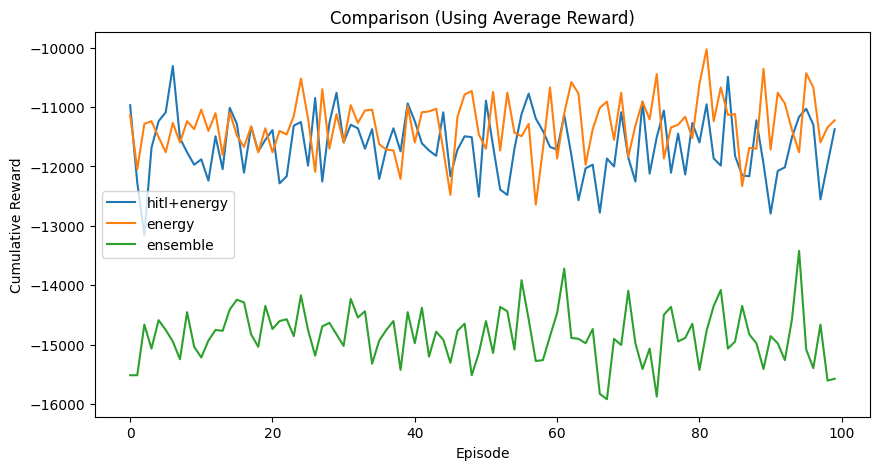

cumulative reward for hitl+energy: -11651.849946
cumulative reward for energy: -11305.447236000009
cumulative reward for ensemble: -14843.692799999993


In [1]:
import math
import random
import matplotlib
import matplotlib.pyplot as plt
from collections import namedtuple, deque
import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from simulation import Simulation

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

Transition = namedtuple('Transition', ('state', 'action', 'next_state', 'reward'))

class ReplayMemory(object):
    def __init__(self, capacity):
        self.memory = deque([], maxlen=capacity)
    def push(self, *args):
        self.memory.append(Transition(*args))
    def sample(self, batch_size):
        return random.sample(self.memory, batch_size)
    def __len__(self):
        return len(self.memory)

model_complexity = 256
class DQN(nn.Module):
    def __init__(self, n_observations, n_actions):
        super(DQN, self).__init__()
        self.layer1 = nn.Linear(n_observations, model_complexity)
        self.layer2 = nn.Linear(model_complexity, model_complexity)
        self.layer4 = nn.Linear(model_complexity, n_actions)
    def forward(self, x):
        x = F.relu(self.layer1(x))
        x = F.relu(self.layer2(x))
        return self.layer4(x)

class ActionSpace():
    def __init__(self):
        self.true_action_space = np.round(np.arange(20, 28, 0.2), 2)
        self.action_space = np.arange(0, len(self.true_action_space), 1)
        self.n = len(self.action_space)
    def convert(self, n):
        return self.true_action_space[n]
    def sample(self):
        return round(self.action_space[np.random.randint(0, self.n)], 2)

action_space = ActionSpace()

def load_model(filepath):
    state_dict = torch.load(filepath)
    n_observations = state_dict['layer1.weight'].shape[1]
    n_actions = action_space.n
    model = DQN(n_observations, n_actions).to(device)
    model.load_state_dict(state_dict)
    return model, n_observations

hitl_energy_model, n_observations = load_model('hitl_model.pth')
energy_model, _ = load_model('energy_model.pth')
ensemble_model, _ = load_model('ensemble_model.pth')

def evaluate_model(model, num_episodes=100):
    sim = Simulation(num_days=1, is_render=False, alpha=0.8, beta=1)
    total_rewards = []
    for _ in range(num_episodes):
        state = sim.reset()
        state = torch.tensor(state, dtype=torch.float32, device=device).unsqueeze(0)
        episode_reward = 0
        while not sim.is_terminate:
            with torch.no_grad():
                action = model(state).max(1)[1].view(1, 1)
            observation, reward, done = sim.step(action_space.convert(action.item()))
            episode_reward += reward
            state = torch.tensor(observation, dtype=torch.float32, device=device).unsqueeze(0)
        total_rewards.append(episode_reward)
    return total_rewards

num_test_episodes = 100
hitl_energy_rewards = evaluate_model(hitl_energy_model, num_episodes=num_test_episodes)
energy_rewards = evaluate_model(energy_model, num_episodes=num_test_episodes)
ensemble_rewards = evaluate_model(ensemble_model, num_episodes=num_test_episodes)

plt.figure(figsize=(10, 5))
plt.plot(hitl_energy_rewards, label='hitl+energy')
plt.plot(energy_rewards, label='energy')
plt.plot(ensemble_rewards, label='ensemble')
plt.xlabel('Episode')
plt.ylabel('Cumulative Reward')
plt.title('Comparison (Using Average Reward)')
plt.legend()
plt.show()

# this is my metric
# calculate and print the average cumulative rewards
avg_hitl_energy_reward = sum(hitl_energy_rewards) / num_test_episodes
avg_energy_reward = sum(energy_rewards) / num_test_episodes
avg_ensemble_reward = sum(ensemble_rewards) / num_test_episodes

print(f"cumulative reward for hitl+energy: {avg_hitl_energy_reward}")
print(f"cumulative reward for energy: {avg_energy_reward}")
print(f"cumulative reward for ensemble: {avg_ensemble_reward}")

# Result
### Best model looks like the energy model since it has the lowest cummulative reward of around -11307, but not sure if this metric suffices.

